In [300]:
# Class dependencies
import numpy as np
from matplotlib import pyplot as plt
from scipy.optimize import minimize
from sklearn.metrics import accuracy_score
from tqdm import tqdm
import pickle


# Other analysis libraries
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation


"""
To import this class into an ipynb file in the same folder:

from model import model3    
"""

'\nTo import this class into an ipynb file in the same folder:\n\nfrom model import model3    \n'

In [301]:
class origaminetworks():
    def __init__(self, layers = 3, width = None, temp = .5, max_iter=1000, tol=1e-8, learning_rate=0.01, reg=.5, optimizer="grad", batch_size=32, epochs=100):
        # Hyperparameters
        self.max_iter = max_iter
        self.tol = tol
        self.learning_rate = learning_rate
        self.optimizer = optimizer
        self.batch_size = batch_size
        self.epochs = epochs
        self.reg = reg
        self.layers = layers
        self.width = width
        self.temp = temp

        # Variables to store
        self.X = None
        self.y = None
        self.n = None
        self.d = None
        self.classes = None
        self.num_classes = None
        self.y_dict = None
        self.one_hot = None
        self.fold_vectors = None
        self.cut_matrix = None
        self.expand_matrix = None
        
        # Check if the model has an expand matrix
        if self.width is not None:
            self.has_expand = True
        else:
            self.has_expand = False

        # Validation variables
        self.X_val_set = None
        self.y_val_set = None
        self.class_index = []
        self.val_history = []
        self.train_history = []
        self.weights_history = []
        

    ############################## Helper Functions ###############################
    def encode_y(self, y:np.ndarray):
        """
        Encode the labels of the data.

        Parameters:
            y (n,) ndarray - The labels of the data
        Returns:
            None
        """
        # Check if the input is a list
        if isinstance(y, list):
            y = np.array(y)

        # Make sure it is a numpy array
        elif not isinstance(y, np.ndarray):
            raise ValueError("y must be a list or a numpy array")
        
        # If it is not integers, give it a dictionary
        if y.dtype != int:
            self.classes = np.unique(y)
            self.y_dict = {label: i for i, label in enumerate(np.unique(y))}

        # If it is, still make it a dictionary
        else:
            self.classes = np.arange(np.max(y)+1)
            self.y_dict = {i: i for i in self.classes}
        self.num_classes = len(self.classes)

        # Create an index array
        for i in range(self.num_classes):
            self.class_index.append(np.where(y == self.classes[i])[0])

        # Make a one hot encoding
        self.one_hot = np.zeros((self.n, self.num_classes))
        for i in range(self.n):
            self.one_hot[i, self.y_dict[y[i]]] = 1

        
    def randomize_batches(self):
        """
        Randomize the batches for stochastic gradient descent
        Parameters:
            None
        Returns:
            batches (list) - A list of batches of indices for training
        """
        # Get randomized indices and calculate the number of batches
        indices = np.arange(self.n)
        np.random.shuffle(indices)
        num_batches = self.n // self.batch_size

        # Loop through the different batches and get the batches
        batches = [indices[i*self.batch_size:(i+1)*self.batch_size].tolist() for i in range(num_batches)]

        # Handle the remaining points
        remaining_points = indices[num_batches*self.batch_size:]
        counter = len(remaining_points)
        i = 0

        # Fill the remaining points into the batches
        while counter > 0:
            batches[i % len(batches)].append(remaining_points[i])
            i += 1
            counter -= 1

        # Return the batches
        return batches
    

    def fold(self, Z, n):
        # Make the scalled inner product and the mask
        scales = (Z@n)/np.dot(n, n)
        mask = scales > 1
        
        # Make the projection and flip the points that are beyond the fold (mask)
        projected = 2 * np.outer(scales, n)
        adjustment = 2*n - projected
        return Z + mask[:,np.newaxis] * adjustment
    
    
    def derivative_fold(self, Z, n):
        # Get the scaled inner product, mask, and make the identity stack
        n_normal = n / np.dot(n,n)
        scales = Z@n_normal
        mask = scales > 1
        identity_stack = np.stack([np.eye(self.width) for _ in range(len(Z))])
        
        # Calculate the first component and a helper term
        first_component = (1 - scales[:,np.newaxis, np.newaxis]) * identity_stack
        helper = 2*Z @ n_normal
        
        # Calculate the outer product of n and helper, then subtract the input
        outer_product = np.outer(helper, n_normal) - Z
        second_component = np.einsum('ij,k->ikj', outer_product, n_normal)
        
        # Return the derivative
        return 2 * mask[:,np.newaxis, np.newaxis] * (first_component + second_component)
    
    
    ############################## Training Calculations ##############################
    def forward_pass(self, D:np.ndarray):
        """
        Perform a forward pass of the data through the model

        Parameters:
            D (n,d) ndarray - The data to pass through the model"""
        # Expand to a higher dimension if necessary
        if self.has_expand:
            Z = D @ self.expand_matrix.T
            output = [D, Z]
            input = Z
        
        # If there is no expand matrix, just use the data
        else:
            output = [D]
            input = D
        
        # Loop through the different layers and fold the data
        for i in range(self.layers):
            folded = self.fold(input, self.fold_vectors[i])
            output.append(folded)
            input = folded
        
        # add a column of ones and make the final cut with the softmax
        cut = np.concatenate((input,np.ones((input.shape[0],1))), axis=1) @ self.cut_matrix.T
        
        # Normalize the cut and get the softmax
        cut = (cut / np.max(cut)) * self.temp * 200
        print(cut)
        exponential = np.exp(cut)
        softmax = exponential / np.sum(exponential, axis=1, keepdims=True)
        output.append(softmax)

        # Return the output
        return output
    
    def back_propagation(self, indices:np.ndarray):
        """
        Perform a back propagation of the data through the model

        Parameters:
            indices (ndarray) - The indices of the data to back propagate
        Returns:
            gradient list - The gradient of the model (ndarrays)
        """
        # Get the correct one hot encoding and the correct data and initialize the gradient
        D = self.X[indices]
        one_hot = self.one_hot[indices]
        gradient = []
        
        # Run the forward pass and get the softmax and outer layer
        forward = self.forward_pass(D)
        softmax = forward[-1]
        outer_layer = softmax - one_hot
        
        # Append ones to the forward pass and calculuate the W gradient, appending to the list
        second_stage_forward = np.concatenate((forward[-2],np.ones((forward[-2].shape[0],1))), axis=1)
        dW = np.einsum('ik,id->kd', outer_layer, second_stage_forward)
        gradient.append(dW)
        
        # Calculate the gradients of each fold using the forward propogation
        start_index = 1 if self.has_expand else 0
        fold_grads = [self.derivative_fold(forward[i + start_index], self.fold_vectors[i]) for i in range(self.layers)]
        
        # Perform the back propogation for the folds
        backprop_start = outer_layer @ self.cut_matrix[:,:-1]
        for i in range(self.layers):
            backprop_start = np.einsum('ij,ijk->ik', backprop_start, fold_grads[-i-1])
            gradient.append(np.sum(backprop_start, axis=0))
            
        # If there is an expand matrix, calculate the gradient for that
        if self.has_expand:
            dE = np.einsum('ik,id->kd', backprop_start, forward[0])
            gradient.append(dE)
            
        # Return the gradient
        return gradient
        
        
    
    ########################## Optimization and Training Functions ############################
    def gradient_descent(self):
        """
        Perform gradient descent on the model
        Parameters:
            None
        Returns:
            None
        """
        # Loop through and get the gradient
        for i in range(self.max_iter):
            gradient = self.back_propagation(np.arange(self.n))
            
            # Clip any gradients that are too large
            max_norm = 5.0
            for g in gradient:
                np.clip(g, -max_norm, max_norm, out=g)
            
            # Save the weights if regualarization is not 0
            if self.reg != 0:
                cut_reg = self.reg * self.cut_matrix
                fold_reg = [self.reg * fold for fold in self.fold_vectors]
                if self.has_expand:
                    expand_reg = self.reg * self.expand_matrix

            # Update the weights of the cut matrix and the cut biases
            self.cut_matrix -= self.learning_rate * gradient[0]

            # Update the fold vectors
            for i in range(self.layers):
                self.fold_vectors[i] -= self.learning_rate * gradient[i+1]
                
            # Update the expand matrix if necessary
            if self.has_expand:
                self.expand_matrix -= self.learning_rate * gradient[-1]
                
            # Regularize the weights if it is not 0
            if self.reg != 0:
                self.cut_matrix += cut_reg
                for i in range(self.layers):
                    self.fold_vectors[i] += fold_reg[i]
                if self.has_expand:
                    self.expand_matrix += expand_reg


    def fit(self, X:np.ndarray, y:np.ndarray, X_val_set=None, y_val_set=None):
        """
        Fit the model to the data

        Parameters:
            X (n,d) ndarray - The data to fit the model on
            y (n,) ndarray - The labels of the data
            X_val_set (n_val,d) ndarray - The validation set for the data
            y_val_set (n_val,) ndarray - The validation labels for the data
        Returns:
            train_history (list) - A list of training accuracies
            val_history (list) - A list of validation accuracies
        """
        # Save the data as variables and encode y
        self.X = np.array(X)
        self.y = np.array(y)
        self.n = X.shape[0]
        self.d = X.shape[1]
        self.encode_y(y)

        # Initialize the expand matrix if necessary
        if self.has_expand:
            self.expand_matrix = .1 * np.random.randn(self.width, self.d)
        else:
            self.width = self.d
           
        # Initialize the cut matrix, fold vectors, and b
        self.cut_matrix = .1 * np.random.randn(self.num_classes, self.width + 1)
        self.fold_vectors = .1 * np.random.randn(self.layers, self.width)

        # If there is a validation set, save it
        if X_val_set is not None and y_val_set is not None:
            self.X_val_set = X_val_set
            self.y_val_set = y_val_set

        # Run the optimizer
        if self.optimizer == "sgd":
            raise ValueError("Stochastic Gradient Descent is not implemented yet")
            self.stochastic_gradient_descent()
        elif self.optimizer == "grad":
            self.gradient_descent()

        # Otherwise, raise an error
        else:
            raise ValueError("Optimizer must be 'sgd' or 'grad'")
        

    ############################## Prediction Functions #############################
    def predict(self, points:np.ndarray, show_probabilities=False):
        """
        Predict the labels of the data

        Parameters:
            points (n,d) ndarray - The data to predict the labels of
            show_probabilities (bool) - Whether to show the probabilities of the classes
        Returns:
            predictions (n,) ndarray - The predicted labels of the data
        """
        # Get the probabilities of the classes
        probabilities = self.forward_pass(points)[-1]
        
        # Get the predictions
        predictions = np.argmax(probabilities, axis=1)
        
        # Get the dictionary of the predictions
        predictions = np.array([self.classes[prediction] for prediction in predictions])
        
        # Return the predictions
        if show_probabilities:
            return probabilities
        else:
            return predictions

[[-2.45052227e+01  5.78171949e+01]
 [-3.09376245e+01  4.77197127e+01]
 [-3.73700263e+01  3.76222306e+01]
 [-4.38111103e+01  2.75064592e+01]
 [-5.20411643e+01  1.36222104e+01]
 [-6.02712183e+01 -2.62038366e-01]
 [-6.85012723e+01 -1.41462872e+01]
 [-7.67313263e+01 -2.80305359e+01]
 [-8.49613803e+01 -4.19147847e+01]
 [-9.31914343e+01 -5.57990335e+01]
 [-1.01421488e+02 -6.96832823e+01]
 [-1.09651542e+02 -8.35675311e+01]
 [-1.17881596e+02 -9.74517799e+01]
 [-1.26111650e+02 -1.11336029e+02]
 [-1.34341704e+02 -1.25220277e+02]
 [-1.42571758e+02 -1.39104526e+02]
 [-1.50801812e+02 -1.52988775e+02]
 [-1.59031866e+02 -1.66873024e+02]
 [-1.67261920e+02 -1.80757273e+02]
 [-1.75491974e+02 -1.94641521e+02]
 [-2.26974419e+01  6.00373425e+01]
 [-2.91298437e+01  4.99398603e+01]
 [-3.55622455e+01  3.98423782e+01]
 [-4.21757635e+01  2.93633734e+01]
 [-5.04058175e+01  1.54791246e+01]
 [-5.86358715e+01  1.59487579e+00]
 [-6.68659255e+01 -1.22893730e+01]
 [-7.50959795e+01 -2.61736218e+01]
 [-8.33260335e+01 -4

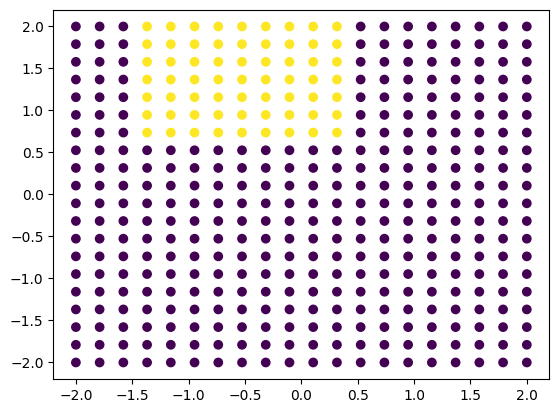

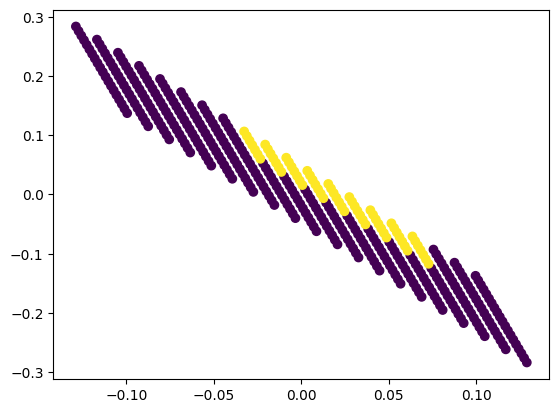

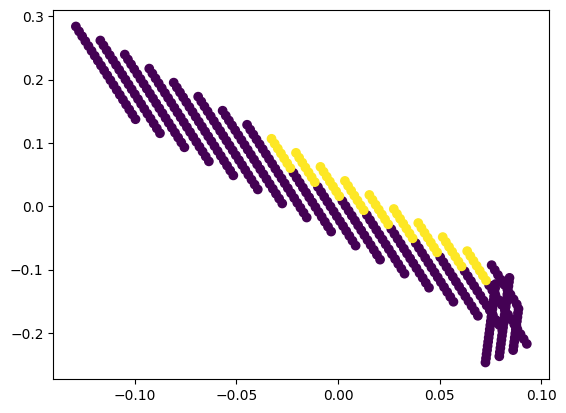

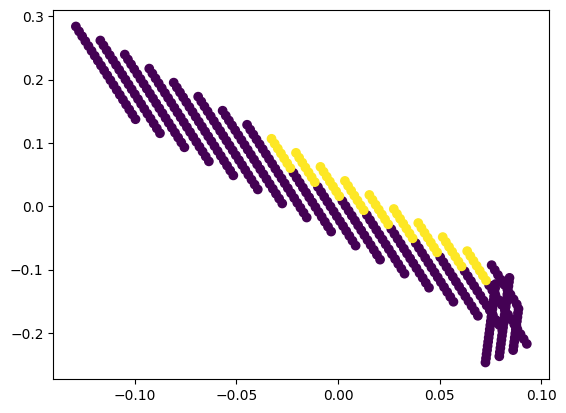

In [312]:
# layer = lambda D, n: D - 2 * np.outer((D@n)/np.dot(n, n), n)
def layer(D, n):
    scales = (D@n)/np.dot(n, n)
    mask = scales > 1
    projected = 2 * np.outer(scales, n)
    adjustment = 2*n - projected
    return D + mask[:,np.newaxis] * adjustment

fv1 = .5*np.array([1,1])
fv2 = np.array([-1,1])
fv3 = np.array([-.85,0])

# make a meshgrid of x and y values
x1 = np.linspace(-2,2,20)
x2 = np.linspace(-2,2,20)
X1,X2 = np.meshgrid(x1,x2)

# reshape the meshgrid into a 2D array and concatenate them
X1 = X1.reshape(-1,1)
X2 = X2.reshape(-1,1)
pairs = np.concatenate((X1,X2),axis=1)
cut1 = layer(pairs, fv1)
cut2 = layer(cut1, fv2)
cut = layer(cut2, fv3)
Y = cut[:,1] > .6

test = origaminetworks(layers = 2, width = 4, max_iter=100, learning_rate=0.0000001, reg=0, optimizer="grad", batch_size=32, epochs=100)
test.fit(pairs,Y)
out = test.forward_pass(pairs)
for i in range(len(out)-1):
    plt.scatter(out[i][:,0],out[i][:,1], c = Y)
    plt.show()

# test.back_propagation(np.arange(10))
# print(forward)
# print([(i, test.fold_vectors[i-1]) for i in range(test.layers, 0, -1)])
# [test.derivative_fold(forward[i], test.fold_vectors[i-1]) for i in range(test.layers, 0, -1)]

[[-7.25827028e+00  4.44244000e+01]
 [ 2.04455438e+01  4.73521947e+01]
 [-1.59161532e+02  1.37897020e+01]
 [-4.50053994e+01  6.07516229e+00]
 [-5.55090086e+01  4.43375178e+01]
 [ 2.38348764e+01  1.92895338e+01]
 [-1.21834974e+02  1.95394824e+01]
 [ 3.65685504e+01  1.49959611e+01]
 [ 2.05112385e+01  2.73554567e+01]
 [ 4.66894605e+01  1.55771134e+01]
 [ 1.28253012e+01  5.57818765e+00]
 [-9.93095632e+01  4.65874970e+01]
 [-1.10543335e+02  7.48294631e+01]
 [-1.08038253e+02  1.04232830e+01]
 [-1.10470216e+02  5.50068090e+01]
 [ 7.71099851e+00  5.70294287e+01]
 [ 3.67499884e+00  1.27046136e+01]
 [ 1.88701614e+01  2.59452429e+01]
 [-5.20180462e+01  3.26333890e+01]
 [-4.17830044e+01  4.13468559e+00]
 [-3.60343000e+01  2.22981796e+01]
 [-1.12228319e+02  1.13483440e+01]
 [ 1.37314800e+01  3.68164760e+00]
 [ 4.52282990e+00  3.39881565e+00]
 [-6.05656324e+01  5.26948208e+01]
 [ 8.30639854e+00  3.02348969e+01]
 [-6.61461894e+00  6.69934748e+01]
 [-3.83423984e+01  1.45896250e+01]
 [ 2.44709903e+01  1

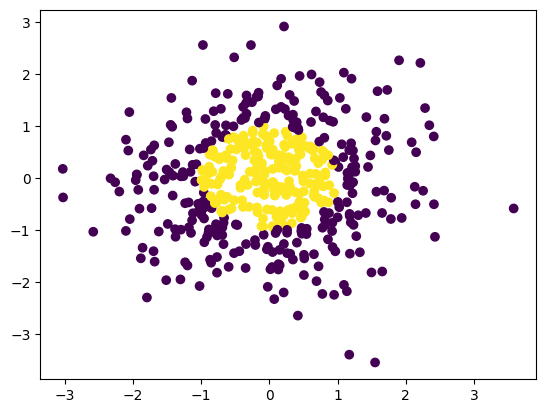

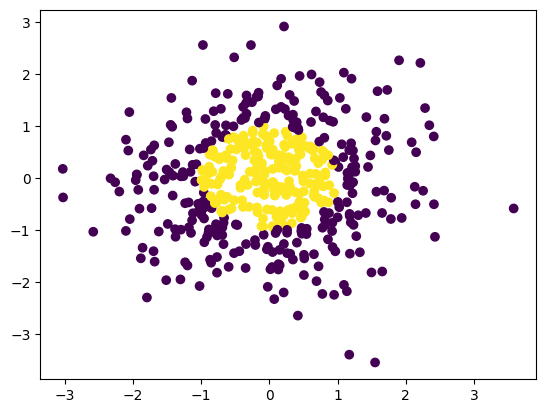

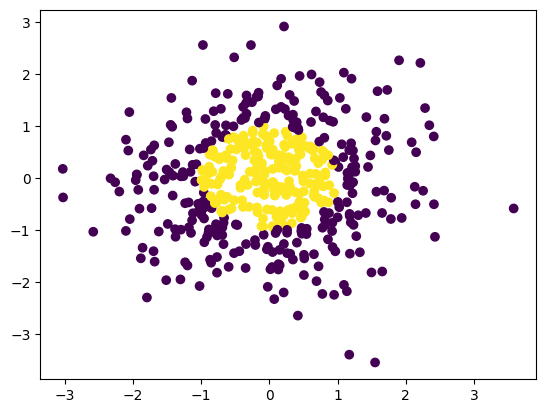

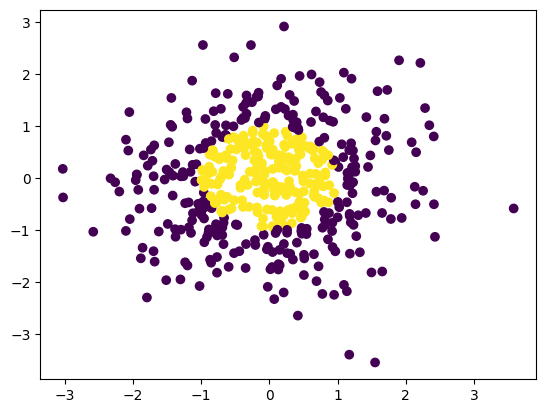

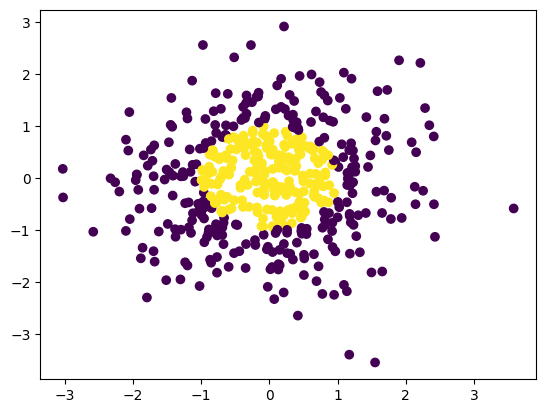

In [304]:
# Set up the model
layers = 4
width = 2
model = origaminetworks(layers=layers, max_iter=1000, learning_rate=0.001)

# Create some dummy data
X = np.random.randn(500, width)
y = np.linalg.norm(X, axis=1) < 1

# # plot the data
# plt.scatter(X[:,0], X[:,1], c=y)
# plt.show()

# Set model parameters
model.fit(X, y)
print(model.fold_vectors)


out = model.forward_pass(X)
for i in range(len(out)-1):
    plt.scatter(out[i][:,0],out[i][:,1], c = y)
    plt.show()
    

In [305]:
y_hat = model.predict(X)

from sklearn.metrics import accuracy_score
print(accuracy_score(y, y_hat))




[[ 6.47200679e+01 -1.24647679e+01]
 [ 1.12257595e+01  1.48689037e+01]
 [-5.07674945e+01 -4.17919687e+00]
 [ 3.52885582e+00 -8.28133738e+00]
 [-1.62934167e+01  1.19936229e+01]
 [ 2.92069544e+01  3.21022256e+00]
 [-2.35499426e+01 -9.09794140e+00]
 [ 3.71665407e+01 -4.75057652e+00]
 [ 5.18677767e+01 -2.74715653e+00]
 [ 4.06391463e+01 -4.22315826e+00]
 [ 7.25790940e+00 -1.74592850e-01]
 [ 4.30673183e+01 -1.85279296e+01]
 [ 9.19207700e+01  4.88574266e+00]
 [-3.32429965e+01 -3.54221543e+00]
 [-3.58324747e+01  1.44851710e+01]
 [ 3.68717974e+01  1.50177424e+01]
 [ 2.53436405e+01 -6.39628462e+00]
 [ 4.70471956e+01 -7.70687987e+00]
 [-1.53732615e+01  7.91230312e+00]
 [-1.25062163e+01 -1.98424045e+00]
 [-9.90142304e+00  4.61452935e+00]
 [-3.40511301e+01 -3.81361511e+00]
 [ 9.73386129e+00 -2.45612047e+00]
 [ 4.19599583e+00 -1.14703466e+00]
 [ 6.03382274e+01  7.03705640e+00]
 [ 3.51975220e+01  5.60952140e+00]
 [ 1.00000000e+02 -6.04122176e+00]
 [-1.09593495e+01  1.81714755e+00]
 [ 1.20372665e+01 -1

[[ -2.59399564 -17.47317342 -36.36193267 ... -50.66347875  -7.75658064
  -21.1875473 ]
 [-19.15941469 -23.81849735  -4.93493624 ... -32.56667754   1.85444036
   -3.10609155]
 [-13.17712219  -0.90465899 -11.92211549 ... -19.63046483  -6.50895051
  -14.40414104]
 ...
 [ -8.75268239 -14.76149662 -10.75547427 ... -22.08300826  12.5231241
  -19.17892975]
 [ -1.60109754 -26.15453411  -9.36943717 ... -42.47355733 -14.7553151
   -4.73473409]
 [-13.74653028 -26.42085245   7.39437615 ... -30.61147471  -4.1226645
  -11.85907177]]
[[ 1.52296440e+01  6.31969987e+00 -3.39910021e+01 ... -5.92058862e+01
   1.74148577e+01 -4.98102626e+00]
 [-1.85031015e+01 -1.49091729e+01  8.06604611e+00 ... -3.77872392e+01
   2.21375469e+01  1.43450862e+01]
 [-8.13872616e+00  2.13127019e+01  2.90455348e+00 ... -1.75640054e+01
   1.41105240e+01  4.47692016e-02]
 ...
 [-1.58488824e+00 -7.26109241e-01 -3.41757350e-01 ... -2.18441721e+01
   3.88234939e+01 -9.29042854e+00]
 [ 1.29537743e+01 -9.77682991e+00  5.24166349e+00 

/var/folders/9v/hm3yvdxd3qd5ftxpdc6tmmmm0000gn/T/ipykernel_16915/3189878097.py:168: RuntimeWarning: overflow encountered in matmul
  cut = np.concatenate((input,np.ones((input.shape[0],1))), axis=1) @ self.cut_matrix.T
/var/folders/9v/hm3yvdxd3qd5ftxpdc6tmmmm0000gn/T/ipykernel_16915/3189878097.py:171: RuntimeWarning: invalid value encountered in divide
  cut = (cut / np.max(cut)) * self.temp * 200


[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]
[[nan nan nan ... nan nan nan]
 [nan nan

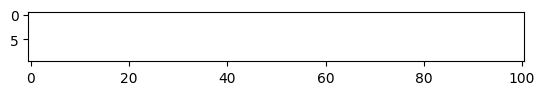

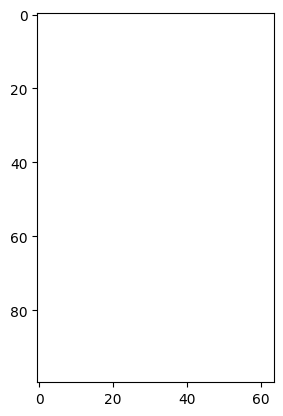

In [307]:
# import small digits dataset
from sklearn.datasets import load_digits
digits = load_digits()
X = digits.data
y = digits.target

# split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# set up the model
model = origaminetworks(layers=0, width = 100, max_iter=1000, learning_rate=0.0001)
model.fit(X_train, y_train)

# get the predictions
y_hat = model.predict(X_test)
print(accuracy_score(y_test, y_hat))
plt.imshow(model.cut_matrix)
plt.show()
plt.imshow(model.expand_matrix)

